In [40]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
%matplotlib inline

def feigenbaum(x0,r,n,lastN=-10):
    xn=x0
    X = [xn]
    for i in range(n):
        xnn = r*xn*(1-xn)
        X.append(xnn)
        xn = xnn
    return set(X[lastN:])

feigenbaumX = []
feigenbaumR = []
for r in np.linspace(1,4,10000):
    xs = feigenbaum(0.05,r,1000)
    for x in xs:
        feigenbaumX.append(x)
        feigenbaumR.append(r)

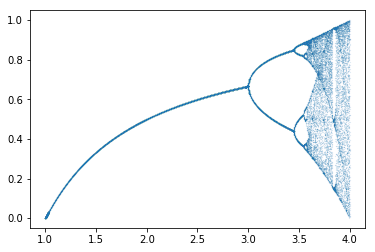

In [41]:
plt.plot(feigenbaumR,feigenbaumX,markersize=0.1,marker='.',linewidth=0)

In [42]:
def mandelbrot(c,n,m):
    Z=np.array([])
    z=np.complex(0,0)
    for i in range(n):
        z = z*z+c
        Z = np.append(Z,z)
        if np.isnan(z):
            return False, Z
    return True, np.unique(Z[-m:])

In [ ]:
X=np.array([])
Y=np.array([])
Z=np.array([])

xMin,xMax = [-2.0,0.5]
yMin,yMax = [-1.0,1.0]

for x in np.linspace(xMin,xMax,100):
    print(round(x,3),end=' ')
    for y in np.linspace(yMin,yMax,100):
        flag, zs = mandelbrot(np.complex(x,y),2000,20)
        if flag:
            for z in zs:
                X = np.append(X,x)
                Y = np.append(Y,y)
                Z = np.append(Z,z)
                
d = {'X': X, 'Y': Y, 'Z': Z,'size':0.1}
df = pd.DataFrame(data=d)
df['Zreal']  = df['Z'].to_numpy().real
df['Zabs']   = np.absolute(df['Z'].to_numpy())
df['Zphase'] = np.angle(df['Z'])
df['Zconst'] = 0*df['Zreal'].to_numpy().real - 2

-2.0 -1.975 -1.949 -1.924 -1.899 -1.874 -1.848 -1.823 -1.798 -1.773 -1.747 -1.722 -1.697 -1.672 -1.646 -1.621 -1.596 -1.571 -1.545 -1.52 -1.495 -1.47 -1.444 -1.419 -1.394 -1.369 -1.343 -1.318 -1.293 -1.268 -1.242 -1.217 -1.192 -1.167 -1.141 -1.116 -1.091 -1.066 -1.04 -1.015 -0.99 -0.965 -0.939 -0.914 -0.889 -0.864 -0.838 -0.813 -0.788 -0.763 -0.737 -0.712 -0.687 -0.662 -0.636 -0.611 -0.586 -0.561 -0.535 -0.51 -0.485 -0.46 -0.434 -0.409 -0.384 -0.359 -0.333 -0.308 -0.283 -0.258 -0.232 -0.207 -0.182 -0.157 -0.131 -0.106 -0.081 -0.056 -0.03 -0.005 0.02 0.045 0.071 0.096 0.121 

In [ ]:
fig = px.scatter_3d(df, x='X', y='Y', z='Zconst', 
                    size='size', symbol='size', color='Zabs', size_max=4, opacity=0.7)

# tight layout
fig.update_traces(marker=dict(size=1,
                              line=dict(width=0,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

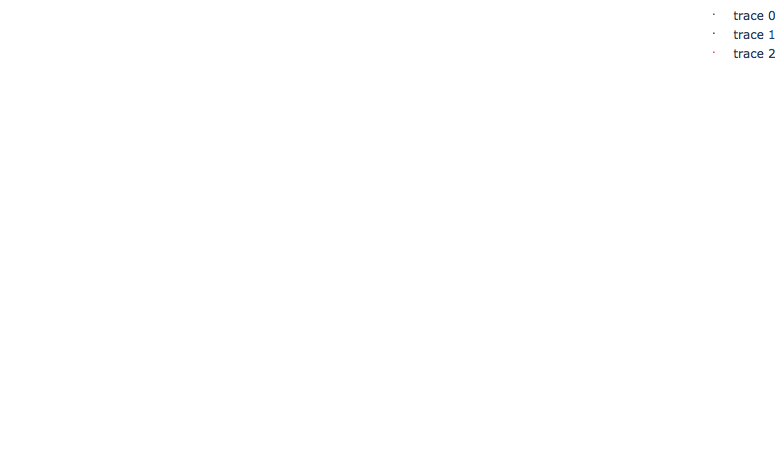

In [34]:
fig = go.Figure(data=[go.Scatter3d(
    x=df['X'],
    y=df['Y'],
    z=df['Zabs'],
    mode='markers',
    marker=dict(
        size=0.5,
        color=df['Zphase'],           # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.7,
        line=dict(
                color='red',
                width=0
        )
    )
)])

fig.add_trace(go.Scatter3d(
    x=df['X'],
    y=df['Y'],
    z=df['Zconst'],
    mode='markers',
    marker=dict(
        size=1,
        color='black',           # set color to an array/list of desired values
        opacity=0.7,
        line=dict(
                color='red',
                width=0
        )
    )
))

fig.add_trace(go.Scatter3d(
    x=np.array(feigenbaumR)/2*(1-np.array(feigenbaumR)/2),
    y=np.array(feigenbaumR)*0,
    z=-0.5*np.array(feigenbaumR)+np.array(feigenbaumR)*feigenbaumX,
    mode='markers',
    marker=dict(
        size=0.3,
        color='red',           # set color to an array/list of desired values
        opacity=0.7,
        line=dict(
                color='red',
                width=0
        )
    )
))

# tight layout
#fig.update_layout(scene_aspectmode='manual',scene_aspectratio=dict(x=1, y=0.5, z=1))
fig.update_layout(scene_aspectmode='data')
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()